Se intenta demostrar la siguiente hipótesis:

### Durante la temporada alta (Julio, Agosto y Septiembre), se registran mayor cantidad de accidentes de tráfico en los barrios más turísticos de la ciudad de Barcelona debido a la numerosa presencia de turistas.

In [1]:
import pandas as pd
import os
import sys
import utils.folders_tb as fo
import utils.mining_data_tb as mi
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

## Data Wrangling

En el afán de demostrar la hipótesis planteada, se comienza a realizar el tratamiento de los datos recopilados para poder trabajar con ellos posteriormente. Para esto, se crean las correspondientes listas de dataframes, con los datasets de cada año (desde el 2010 hasta el 2020).

In [2]:
lista_df_gu = fo.enlistar_dataframes('_ACCIDENTS_GU_BCN_')

Al tratarse de diferentes conjuntos de datos (uno para cada año), es probable que el formato utilizado para recopilar la información haya sufrido algunas modificaciones que deberían subsanarse.

Se comparan las columnas de los dataframes de cada año para verificarlo.

In [3]:
mi.comparar_columnas(lista_df_gu)

Las columnas de 0 (25) y 1 (25) COINCIDEN.
Las columnas de 1 (25) y 2 (25) COINCIDEN.
Las columnas de 2 (25) y 3 (25) COINCIDEN.
Las columnas de 3 (25) y 4 (25) COINCIDEN.

Las columnas de 4 (25) y 5 (25) SON DISTINTAS.

         Posición de columna diferente: 0
         ---------------------------------
         Columna de DF en posición 4: Número d'expedient
         Columna de DF en posición 5: Número d expedient

         Posición de columna diferente: 3
         ---------------------------------
         Columna de DF en posición 4: NK barri
         Columna de DF en posición 5: Codi barri

         Posición de columna diferente: 9
         ---------------------------------
         Columna de DF en posición 4: Dia de setmana
         Columna de DF en posición 5: Dia setmana

4 (25) y 6 (27) tienen distinta CANTIDAD de columnas.
4 (25) y 7 (27) tienen distinta CANTIDAD de columnas.
4 (25) y 8 (27) tienen distinta CANTIDAD de columnas.
4 (25) y 9 (27) tienen distinta CANTIDAD de co

In [4]:
mi.nombre_cada_columna(lista_df_gu)

Columna en posición 0

DF en posición 0: Número d'expedient
DF en posición 1: Número d'expedient
DF en posición 2: Número d'expedient
DF en posición 3: Número d'expedient
DF en posición 4: Número d'expedient
DF en posición 5: Número d expedient
DF en posición 6: Numero_expedient
DF en posición 7: Numero_expedient
DF en posición 8: Numero_expedient
DF en posición 9: Numero_expedient
DF en posición 10: Numero_expedient

-------------------------------------

Columna en posición 1

DF en posición 0: Codi districte
DF en posición 1: Codi districte
DF en posición 2: Codi districte
DF en posición 3: Codi districte
DF en posición 4: Codi districte
DF en posición 5: Codi districte
DF en posición 6: Codi_districte
DF en posición 7: Codi_districte
DF en posición 8: Codi_districte
DF en posición 9: Codi_districte
DF en posición 10: Codi_districte

-------------------------------------

Columna en posición 2

DF en posición 0: Nom districte
DF en posición 1: Nom districte
DF en posición 2: Nom dis

Se realiza un análisis de cuáles serían los datos de interés para definir los oportunos a la hora de llevar adelante el estudio.

Se define así, que las columnas que formarán parte del nuevo conjunto de datos serán:
- Número de expediente
- Nombre de distrito
- Nombre de barrio
- Nombre de calle
- Día de la semana
- Año
- Mes
- Día
- Hora
- Turno
- Número de víctimas
- Número de lesionados leves
- Número de lesionados graves
- Número de muertos


In [5]:
df_accidentes = mi.crear_df_gu(lista_df_gu)

In [6]:
df_accidentes

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
0,2010S003688,Sant Martí,el Camp de l'Arpa del Clot,Meridiana,Divendres,2010.0,Maig,28.0,19.0,Tarda,0.0,0.0,0.0,0.0
1,2010S007597,Sant Martí,el Camp de l'Arpa del Clot,Trinxant,Dilluns,2010.0,Novembre,8.0,11.0,Matí,1.0,1.0,0.0,0.0
2,2010S001390,Sant Martí,el Camp de l'Arpa del Clot,Sant Antoni Maria Claret,Dijous,2010.0,Febrer,25.0,13.0,Matí,1.0,1.0,0.0,0.0
3,2010S005416,Sant Martí,el Camp de l'Arpa del Clot,Freser,Dimarts,2010.0,Agost,3.0,14.0,Tarda,1.0,1.0,0.0,0.0
4,2010S008924,Sant Martí,el Camp de l'Arpa del Clot,Indústria,Divendres,2010.0,Desembre,24.0,14.0,Tarda,2.0,2.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102991,2020S006274,Horta-Guinardó,el Carmel,Lluís Marià Vidal,Dijous,2020.0,Desembre,31.0,17.0,Tarda,0.0,0.0,0.0,0.0
102992,2020S006275,Eixample,Sant Antoni,Sepúlveda,Dijous,2020.0,Desembre,31.0,20.0,Tarda,2.0,2.0,0.0,0.0
102993,2020S006276,Ciutat Vella,el Barri Gòtic,Litoral (Llobregat),Dijous,2020.0,Desembre,31.0,13.0,Matí,2.0,2.0,0.0,0.0
102994,2020S006277,Eixample,la Nova Esquerra de l'Eixample,Aragó,Dijous,2020.0,Desembre,31.0,21.0,Tarda,2.0,2.0,0.0,0.0


Se realizan algunas búsquedas para diferentes números de expediente como método de verificación.

In [7]:
df_accidentes.iloc[400,:]

NUMERO EXPEDIENTE              2010S004517
DISTRITO               Sarrià-Sant Gervasi
BARRIO                     les Tres Torres
CALLE                             Bonanova
DIA SEMANA                         Dimarts
ANO                                 2010.0
MES                                   Juny
DIA                                   29.0
HORA                                  20.0
TURNO                                Tarda
NUMERO VICTIMAS                        1.0
VICTIMAS LEVES                         1.0
VICTIMAS GRAVES                        0.0
VICTIMAS FALLECIDAS                    0.0
Name: 400, dtype: object

In [8]:
df_accidentes[df_accidentes['NUMERO EXPEDIENTE'] == '2010S004517']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
400,2010S004517,Sarrià-Sant Gervasi,les Tres Torres,Bonanova,Dimarts,2010.0,Juny,29.0,20.0,Tarda,1.0,1.0,0.0,0.0


---

In [9]:
df_accidentes.iloc[8000,:]

NUMERO EXPEDIENTE          2010S008942
DISTRITO                  Ciutat Vella
BARRIO                        el Raval
CALLE                  Litoral (Besòs)
DIA SEMANA                    Dissabte
ANO                             2010.0
MES                           Desembre
DIA                               25.0
HORA                               6.0
TURNO                             Matí
NUMERO VICTIMAS                    0.0
VICTIMAS LEVES                     0.0
VICTIMAS GRAVES                    0.0
VICTIMAS FALLECIDAS                0.0
Name: 8000, dtype: object

In [10]:
df_accidentes[df_accidentes['NUMERO EXPEDIENTE'] == '2010S008942']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
8000,2010S008942,Ciutat Vella,el Raval,Litoral (Besòs),Dissabte,2010.0,Desembre,25.0,6.0,Matí,0.0,0.0,0.0,0.0


---

In [11]:
df_accidentes.iloc[38000,:]

NUMERO EXPEDIENTE                        2014S002077
DISTRITO                                  Sant Martí
BARRIO                 la Vila Olímpica del Poblenou
CALLE                            Litoral (Llobregat)
DIA SEMANA                                    Dijous
ANO                                           2014.0
MES                                             Març
DIA                                             20.0
HORA                                            15.0
TURNO                                          Tarda
NUMERO VICTIMAS                                  1.0
VICTIMAS LEVES                                   1.0
VICTIMAS GRAVES                                  0.0
VICTIMAS FALLECIDAS                              0.0
Name: 38000, dtype: object

In [12]:
df_accidentes[df_accidentes['NUMERO EXPEDIENTE'] == '2014S002077']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
38000,2014S002077,Sant Martí,la Vila Olímpica del Poblenou,Litoral (Llobregat),Dijous,2014.0,Març,20.0,15.0,Tarda,1.0,1.0,0.0,0.0


---

In [13]:
df_accidentes.iloc[88000,:]

NUMERO EXPEDIENTE                                        2019S001301    
DISTRITO                                                        Eixample
BARRIO                                                       Sant Antoni
CALLE                  Viladomat / Corts Catalanes                   ...
DIA SEMANA                                                       Dilluns
ANO                                                               2019.0
MES                                                               Febrer
DIA                                                                 18.0
HORA                                                                14.0
TURNO                                                              Tarda
NUMERO VICTIMAS                                                      1.0
VICTIMAS LEVES                                                       1.0
VICTIMAS GRAVES                                                      0.0
VICTIMAS FALLECIDAS                                

In [14]:
df_accidentes.iloc[88000,:]['NUMERO EXPEDIENTE']

'2019S001301    '

In [15]:
df_accidentes.iloc[88000,:]['CALLE']

'Viladomat / Corts Catalanes                       '

In [16]:
df_accidentes[df_accidentes['NUMERO EXPEDIENTE'] == '2019S001301    ']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
88000,2019S001301,Eixample,Sant Antoni,Viladomat / Corts Catalanes ...,Dilluns,2019.0,Febrer,18.0,14.0,Tarda,1.0,1.0,0.0,0.0


---

In [17]:
df_accidentes.iloc[100000,:]

NUMERO EXPEDIENTE      2020S003281    
DISTRITO                      Eixample
BARRIO                   el Fort Pienc
CALLE                  Corts Catalanes
DIA SEMANA                     Dilluns
ANO                             2020.0
MES                             Juliol
DIA                               20.0
HORA                              13.0
TURNO                             Matí
NUMERO VICTIMAS                    2.0
VICTIMAS LEVES                     2.0
VICTIMAS GRAVES                    0.0
VICTIMAS FALLECIDAS                0.0
Name: 100000, dtype: object

In [18]:
df_accidentes[df_accidentes['NUMERO EXPEDIENTE'] == '2020S003281    ']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
100000,2020S003281,Eixample,el Fort Pienc,Corts Catalanes,Dilluns,2020.0,Juliol,20.0,13.0,Matí,2.0,2.0,0.0,0.0


Se observa un inconveniente. Aparentemente, para los últimos años, se han agregado espacios en blanco al final de algunos strings. Se procede a corregir este obstáculo para contar con datos unificados.

In [19]:
mi.quitar_espacios(df_accidentes)

Ahora se puede ver cómo los strings no cuentan con espacios en blanco ni al inicio ni al final.

In [20]:
df_accidentes.iloc[88000,:]

NUMERO EXPEDIENTE                      2019S001301
DISTRITO                                  Eixample
BARRIO                                 Sant Antoni
CALLE                  Viladomat / Corts Catalanes
DIA SEMANA                                 Dilluns
ANO                                         2019.0
MES                                         Febrer
DIA                                           18.0
HORA                                          14.0
TURNO                                        Tarda
NUMERO VICTIMAS                                1.0
VICTIMAS LEVES                                 1.0
VICTIMAS GRAVES                                0.0
VICTIMAS FALLECIDAS                            0.0
Name: 88000, dtype: object

In [21]:
df_accidentes.iloc[100000,:]

NUMERO EXPEDIENTE          2020S003281
DISTRITO                      Eixample
BARRIO                   el Fort Pienc
CALLE                  Corts Catalanes
DIA SEMANA                     Dilluns
ANO                             2020.0
MES                             Juliol
DIA                               20.0
HORA                              13.0
TURNO                             Matí
NUMERO VICTIMAS                    2.0
VICTIMAS LEVES                     2.0
VICTIMAS GRAVES                    0.0
VICTIMAS FALLECIDAS                0.0
Name: 100000, dtype: object

## Data Cleaning

Continuando con la limpieza de los datos para su posterior visualización, se desea verificar la presencia de datos duplicados, para que los mismos no generen resultados alterados indebidos.

In [22]:
print('Dimensiones de df_accidentes:  Filas --> ' + str(df_accidentes.shape[0]) + '  Columnas --> ' + str(df_accidentes.shape[1]) + '\n')
print('Cantidad de números de expediente duplicados en df_accidentes:' , df_accidentes['NUMERO EXPEDIENTE'].duplicated().sum(), '\n')
print('Cantidad de filas duplicadas de df_accidentes:' , df_accidentes.duplicated().sum())


Dimensiones de df_accidentes:  Filas --> 102996  Columnas --> 14

Cantidad de números de expediente duplicados en df_accidentes: 21 

Cantidad de filas duplicadas de df_accidentes: 21


Como se puede observar, el dataframe cuenta con 102996 filas, de las cuales hay 21 que tienen exactamente los mismos datos. Éstas filas generarían una desviación en el análisis, por lo que deben ser removidas.

In [23]:
df_accidentes.drop_duplicates(inplace = True, ignore_index= True)

In [24]:
print('Dimensiones de df_accidentes:  Filas --> ' + str(df_accidentes.shape[0]) + '  Columnas --> ' + str(df_accidentes.shape[1]) + '\n')
print('Cantidad de números de expediente duplicados en df_accidentes:' , df_accidentes['NUMERO EXPEDIENTE'].duplicated().sum(), '\n')
print('Cantidad de filas duplicadas de df_accidentes:' , df_accidentes.duplicated().sum())

Dimensiones de df_accidentes:  Filas --> 102975  Columnas --> 14

Cantidad de números de expediente duplicados en df_accidentes: 0 

Cantidad de filas duplicadas de df_accidentes: 0


Una vez eliminados los datos duplicados, se realiza un análisis de los datos faltantes para definir qué se hará con ellos.

In [25]:
df_accidentes.isnull().sum()

NUMERO EXPEDIENTE      0
DISTRITO               1
BARRIO                 1
CALLE                  2
DIA SEMANA             0
ANO                    1
MES                    1
DIA                    1
HORA                   1
TURNO                  0
NUMERO VICTIMAS        1
VICTIMAS LEVES         1
VICTIMAS GRAVES        1
VICTIMAS FALLECIDAS    1
dtype: int64

Si se evalúan los datos faltantes de la columna "CALLE", se puede observar lo siguiente:

In [26]:
df_accidentes[df_accidentes['CALLE'].isna()]

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
56285,10/02/2016,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,13:25:52,NaN,NaN,NaN,NaN
84385,2018S008677,Sarrià-Sant Gervasi,"Vallvidrera, el Tibidabo i les Planes",NaN,Dilluns,2018.0,Novembre,12.0,0.0,Nit,0.0,0.0,0.0,0.0


Se puede observar que, de los 2 datos faltantes de la columna "CALLE", uno corresponde a una serie de valores anómalos que no aportan valor a la investigación y deben ser eliminados. Por otro lado, el otro, representa un accidente al cual, efectivamente, no se le ha ingresado ningún nombre de calle. Dicho valor nulo no genera mayores inconvenientes, por lo que puede permanecer en el dataframe para no perder el dato del accidente.

In [27]:
df_accidentes.drop(df_accidentes.index[56285], inplace= True)

In [28]:
df_accidentes.reset_index(drop=True, inplace= True)
df_accidentes

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
0,2010S003688,Sant Martí,el Camp de l'Arpa del Clot,Meridiana,Divendres,2010.0,Maig,28.0,19.0,Tarda,0.0,0.0,0.0,0.0
1,2010S007597,Sant Martí,el Camp de l'Arpa del Clot,Trinxant,Dilluns,2010.0,Novembre,8.0,11.0,Matí,1.0,1.0,0.0,0.0
2,2010S001390,Sant Martí,el Camp de l'Arpa del Clot,Sant Antoni Maria Claret,Dijous,2010.0,Febrer,25.0,13.0,Matí,1.0,1.0,0.0,0.0
3,2010S005416,Sant Martí,el Camp de l'Arpa del Clot,Freser,Dimarts,2010.0,Agost,3.0,14.0,Tarda,1.0,1.0,0.0,0.0
4,2010S008924,Sant Martí,el Camp de l'Arpa del Clot,Indústria,Divendres,2010.0,Desembre,24.0,14.0,Tarda,2.0,2.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102969,2020S006274,Horta-Guinardó,el Carmel,Lluís Marià Vidal,Dijous,2020.0,Desembre,31.0,17.0,Tarda,0.0,0.0,0.0,0.0
102970,2020S006275,Eixample,Sant Antoni,Sepúlveda,Dijous,2020.0,Desembre,31.0,20.0,Tarda,2.0,2.0,0.0,0.0
102971,2020S006276,Ciutat Vella,el Barri Gòtic,Litoral (Llobregat),Dijous,2020.0,Desembre,31.0,13.0,Matí,2.0,2.0,0.0,0.0
102972,2020S006277,Eixample,la Nova Esquerra de l'Eixample,Aragó,Dijous,2020.0,Desembre,31.0,21.0,Tarda,2.0,2.0,0.0,0.0


In [29]:
df_accidentes[df_accidentes['CALLE'].isna()]

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
84384,2018S008677,Sarrià-Sant Gervasi,"Vallvidrera, el Tibidabo i les Planes",NaN,Dilluns,2018.0,Novembre,12.0,0.0,Nit,0.0,0.0,0.0,0.0


In [30]:
df_accidentes.nunique()

NUMERO EXPEDIENTE      102974
DISTRITO                   11
BARRIO                     75
CALLE                    8254
DIA SEMANA                  7
ANO                        11
MES                        12
DIA                        31
HORA                       24
TURNO                       3
NUMERO VICTIMAS            18
VICTIMAS LEVES             17
VICTIMAS GRAVES             5
VICTIMAS FALLECIDAS         4
dtype: int64

Aquí se puede apreciar que, al menos, los valores cualitativos son congruentes. Esto significa, que los mismos cuentan con tantos valores únicos como serían los esperados. Por ejemplo, 31 valores únicos para los días del mes, 7 para los días de la semana, o bien 3 para los turnos de un día.

Ahora se procede a evaluar el tipo de valor que contiene cada una de las columnas.

In [31]:
df_accidentes['DISTRITO'].unique()

array(['Sant Martí', 'Ciutat Vella', 'Eixample', 'Sants-Montjuïc',
       'Les Corts', 'Sarrià-Sant Gervasi', 'Gràcia', 'Horta-Guinardó',
       'Nou Barris', 'Sant Andreu', 'Desconegut'], dtype=object)

Para el caso de los distritos, se observa un valor "desconocido". Teniendo en cuenta el propósito del estudio, ese valor no es una buena señal, y sería conveniente cuantificarlo. Ésta situación podría presentarse en otras columnas, por lo que se hará una investigación.

In [32]:
df_accidentes[df_accidentes['DISTRITO'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
592,2010S005007,Desconegut,Desconegut,Desconegut,Dissabte,2010.0,Juliol,17.0,7.0,Matí,1.0,1.0,0.0,0.0
1133,2010S001471,Desconegut,Desconegut,Desconegut,Dilluns,2010.0,Març,1.0,14.0,Tarda,1.0,1.0,0.0,0.0
1134,2010S004750,Desconegut,Desconegut,Desconegut,Dijous,2010.0,Juliol,8.0,13.0,Matí,1.0,1.0,0.0,0.0
1690,2010S006049,Desconegut,Desconegut,Desconegut,Dimarts,2010.0,Setembre,7.0,14.0,Tarda,1.0,1.0,0.0,0.0
2244,2010S000804,Desconegut,Desconegut,Desconegut,Dimecres,2010.0,Febrer,3.0,8.0,Matí,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100879,2020S004180,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Setembre,15.0,14.0,Tarda,1.0,1.0,0.0,0.0
101230,2020S004531,Desconegut,Desconegut,Desconegut,Dijous,2020.0,Octubre,1.0,8.0,Matí,1.0,1.0,0.0,0.0
101855,2020S005158,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Novembre,3.0,9.0,Matí,1.0,1.0,0.0,0.0
101976,2020S005279,Desconegut,Desconegut,Desconegut,Dimecres,2020.0,Novembre,11.0,9.0,Matí,1.0,1.0,0.0,0.0


In [33]:
df_accidentes[df_accidentes['BARRIO'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
592,2010S005007,Desconegut,Desconegut,Desconegut,Dissabte,2010.0,Juliol,17.0,7.0,Matí,1.0,1.0,0.0,0.0
1133,2010S001471,Desconegut,Desconegut,Desconegut,Dilluns,2010.0,Març,1.0,14.0,Tarda,1.0,1.0,0.0,0.0
1134,2010S004750,Desconegut,Desconegut,Desconegut,Dijous,2010.0,Juliol,8.0,13.0,Matí,1.0,1.0,0.0,0.0
1690,2010S006049,Desconegut,Desconegut,Desconegut,Dimarts,2010.0,Setembre,7.0,14.0,Tarda,1.0,1.0,0.0,0.0
2244,2010S000804,Desconegut,Desconegut,Desconegut,Dimecres,2010.0,Febrer,3.0,8.0,Matí,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100879,2020S004180,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Setembre,15.0,14.0,Tarda,1.0,1.0,0.0,0.0
101230,2020S004531,Desconegut,Desconegut,Desconegut,Dijous,2020.0,Octubre,1.0,8.0,Matí,1.0,1.0,0.0,0.0
101855,2020S005158,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Novembre,3.0,9.0,Matí,1.0,1.0,0.0,0.0
101976,2020S005279,Desconegut,Desconegut,Desconegut,Dimecres,2020.0,Novembre,11.0,9.0,Matí,1.0,1.0,0.0,0.0


In [34]:
df_accidentes[df_accidentes['CALLE'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
592,2010S005007,Desconegut,Desconegut,Desconegut,Dissabte,2010.0,Juliol,17.0,7.0,Matí,1.0,1.0,0.0,0.0
1133,2010S001471,Desconegut,Desconegut,Desconegut,Dilluns,2010.0,Març,1.0,14.0,Tarda,1.0,1.0,0.0,0.0
1134,2010S004750,Desconegut,Desconegut,Desconegut,Dijous,2010.0,Juliol,8.0,13.0,Matí,1.0,1.0,0.0,0.0
1690,2010S006049,Desconegut,Desconegut,Desconegut,Dimarts,2010.0,Setembre,7.0,14.0,Tarda,1.0,1.0,0.0,0.0
2244,2010S000804,Desconegut,Desconegut,Desconegut,Dimecres,2010.0,Febrer,3.0,8.0,Matí,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100879,2020S004180,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Setembre,15.0,14.0,Tarda,1.0,1.0,0.0,0.0
101230,2020S004531,Desconegut,Desconegut,Desconegut,Dijous,2020.0,Octubre,1.0,8.0,Matí,1.0,1.0,0.0,0.0
101855,2020S005158,Desconegut,Desconegut,Desconegut,Dimarts,2020.0,Novembre,3.0,9.0,Matí,1.0,1.0,0.0,0.0
101976,2020S005279,Desconegut,Desconegut,Desconegut,Dimecres,2020.0,Novembre,11.0,9.0,Matí,1.0,1.0,0.0,0.0


La estrategia que se sigue en esta situación, es la de reemplazar los valores perdidos ``"desconocido"`` por valores NaN. De esta manera, nuestros datos relacionados con las columnas restantes (cuyo valor es conocido), será tenida en cuenta en el análisis exploratorio, mientras que el valor ``"desconocido"`` no será tomado como un dato, ya sea de ``distrito``, ``barrio`` o ``calle``.

In [35]:
df_accidentes.replace('Desconegut', np.nan, inplace = True)

In [36]:
df_accidentes[df_accidentes['DISTRITO'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS


In [37]:
df_accidentes[df_accidentes['BARRIO'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS


In [38]:
df_accidentes[df_accidentes['CALLE'] == 'Desconegut']

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS


Ahora, se debe tener en cuenta cuál es el tipo de valor de cada una de las columnas.

In [39]:
df_accidentes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102974 entries, 0 to 102973
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   NUMERO EXPEDIENTE    102974 non-null  object 
 1   DISTRITO             102777 non-null  object 
 2   BARRIO               102777 non-null  object 
 3   CALLE                102722 non-null  object 
 4   DIA SEMANA           102974 non-null  object 
 5   ANO                  102974 non-null  float64
 6   MES                  102974 non-null  object 
 7   DIA                  102974 non-null  float64
 8   HORA                 102974 non-null  float64
 9   TURNO                102974 non-null  object 
 10  NUMERO VICTIMAS      102974 non-null  float64
 11  VICTIMAS LEVES       102974 non-null  float64
 12  VICTIMAS GRAVES      102974 non-null  float64
 13  VICTIMAS FALLECIDAS  102974 non-null  float64
dtypes: float64(7), object(7)
memory usage: 11.0+ MB


La presencia de valores NaN en las columnas numéricas ha generado que, los números presentes en el dataframe, que se esperaría sean del tipo "int", figuren como "float64". Esto se puede remediar de la siguiente manera:

In [40]:
df_accidentes = df_accidentes.astype({"ANO": int, "DIA": int, "HORA": int, "NUMERO VICTIMAS": int, "VICTIMAS LEVES": int, "VICTIMAS GRAVES": int, "VICTIMAS FALLECIDAS": int})

In [41]:
df_accidentes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102974 entries, 0 to 102973
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   NUMERO EXPEDIENTE    102974 non-null  object
 1   DISTRITO             102777 non-null  object
 2   BARRIO               102777 non-null  object
 3   CALLE                102722 non-null  object
 4   DIA SEMANA           102974 non-null  object
 5   ANO                  102974 non-null  int32 
 6   MES                  102974 non-null  object
 7   DIA                  102974 non-null  int32 
 8   HORA                 102974 non-null  int32 
 9   TURNO                102974 non-null  object
 10  NUMERO VICTIMAS      102974 non-null  int32 
 11  VICTIMAS LEVES       102974 non-null  int32 
 12  VICTIMAS GRAVES      102974 non-null  int32 
 13  VICTIMAS FALLECIDAS  102974 non-null  int32 
dtypes: int32(7), object(7)
memory usage: 8.2+ MB


In [42]:
df_accidentes

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
0,2010S003688,Sant Martí,el Camp de l'Arpa del Clot,Meridiana,Divendres,2010,Maig,28,19,Tarda,0,0,0,0
1,2010S007597,Sant Martí,el Camp de l'Arpa del Clot,Trinxant,Dilluns,2010,Novembre,8,11,Matí,1,1,0,0
2,2010S001390,Sant Martí,el Camp de l'Arpa del Clot,Sant Antoni Maria Claret,Dijous,2010,Febrer,25,13,Matí,1,1,0,0
3,2010S005416,Sant Martí,el Camp de l'Arpa del Clot,Freser,Dimarts,2010,Agost,3,14,Tarda,1,1,0,0
4,2010S008924,Sant Martí,el Camp de l'Arpa del Clot,Indústria,Divendres,2010,Desembre,24,14,Tarda,2,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102969,2020S006274,Horta-Guinardó,el Carmel,Lluís Marià Vidal,Dijous,2020,Desembre,31,17,Tarda,0,0,0,0
102970,2020S006275,Eixample,Sant Antoni,Sepúlveda,Dijous,2020,Desembre,31,20,Tarda,2,2,0,0
102971,2020S006276,Ciutat Vella,el Barri Gòtic,Litoral (Llobregat),Dijous,2020,Desembre,31,13,Matí,2,2,0,0
102972,2020S006277,Eixample,la Nova Esquerra de l'Eixample,Aragó,Dijous,2020,Desembre,31,21,Tarda,2,2,0,0


Otro inconveniente que se puede observar en el dataframe, pensando ya en el momento de la presentación del mismo, es el idioma. Teniendo en cuenta que el proyecto será presentado ante un público que posiblemente no domine perfectamente la lengua catalana, no estaría demás realizar la conversión al castellano. Para esto, es adecuado centrarse en las columnas que contienen datos a traducir. Estas son:
- Día de la semana
- Mes
- Turno

In [43]:
df_accidentes['DIA SEMANA'].unique()

array(['Divendres', 'Dilluns', 'Dijous', 'Dimarts', 'Dimecres',
       'Diumenge', 'Dissabte'], dtype=object)

In [44]:
df_accidentes['MES'].unique()

array(['Maig', 'Novembre', 'Febrer', 'Agost', 'Desembre', 'Juny',
       'Juliol', 'Setembre', 'Març', 'Gener', 'Octubre', 'Abril'],
      dtype=object)

In [45]:
df_accidentes['TURNO'].unique()

array(['Tarda', 'Matí', 'Nit'], dtype=object)

In [46]:
mi.translate(df_accidentes)

In [47]:
df_accidentes

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
0,2010S003688,Sant Martí,el Camp de l'Arpa del Clot,Meridiana,Viernes,2010,Mayo,28,19,Tarde,0,0,0,0
1,2010S007597,Sant Martí,el Camp de l'Arpa del Clot,Trinxant,Lunes,2010,Noviembre,8,11,Mañana,1,1,0,0
2,2010S001390,Sant Martí,el Camp de l'Arpa del Clot,Sant Antoni Maria Claret,Jueves,2010,Febrero,25,13,Mañana,1,1,0,0
3,2010S005416,Sant Martí,el Camp de l'Arpa del Clot,Freser,Martes,2010,Agosto,3,14,Tarde,1,1,0,0
4,2010S008924,Sant Martí,el Camp de l'Arpa del Clot,Indústria,Viernes,2010,Diciembre,24,14,Tarde,2,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102969,2020S006274,Horta-Guinardó,el Carmel,Lluís Marià Vidal,Jueves,2020,Diciembre,31,17,Tarde,0,0,0,0
102970,2020S006275,Eixample,Sant Antoni,Sepúlveda,Jueves,2020,Diciembre,31,20,Tarde,2,2,0,0
102971,2020S006276,Ciutat Vella,el Barri Gòtic,Litoral (Llobregat),Jueves,2020,Diciembre,31,13,Mañana,2,2,0,0
102972,2020S006277,Eixample,la Nova Esquerra de l'Eixample,Aragó,Jueves,2020,Diciembre,31,21,Tarde,2,2,0,0


Una vez finalizado el Data Cleaning de nuestro conjunto de datos, es recomendable guardar el dataframe obtenido en un fichero .csv en la dirección data/DATA_POST_CLEANING para su rápida lectura y manipulación. Se logra mediante la ejecución de la siguiente función:

In [48]:
fo.df_to_csv_post_cleaning(df_accidentes, 'accidentes.csv')

A partir de ahora, se puede realizar la lectura del archivo obtenido luego de hacer el Data Cleaning de la siguiente manera:

In [49]:
accidentes = fo.leer_csv_post_cleaning('accidentes.csv')

In [50]:
accidentes['NUMERO VICTIMAS'].unique()

array([ 0,  1,  2,  4,  3,  5,  6,  7,  8, 10,  9, 12, 15, 11, 13, 24, 14,
       26], dtype=int64)

In [51]:
accidentes[accidentes['NUMERO VICTIMAS'] == 3].count()

NUMERO EXPEDIENTE      2879
DISTRITO               2875
BARRIO                 2875
CALLE                  2874
DIA SEMANA             2879
ANO                    2879
MES                    2879
DIA                    2879
HORA                   2879
TURNO                  2879
NUMERO VICTIMAS        2879
VICTIMAS LEVES         2879
VICTIMAS GRAVES        2879
VICTIMAS FALLECIDAS    2879
dtype: int64

In [52]:
accidentes[(accidentes['ANO'] == 2017) & (accidentes['MES'] == 'Agosto') & (accidentes['DIA'] == 17)]

,NUMERO EXPEDIENTE,DISTRITO,BARRIO,CALLE,DIA SEMANA,ANO,MES,DIA,HORA,TURNO,NUMERO VICTIMAS,VICTIMAS LEVES,VICTIMAS GRAVES,VICTIMAS FALLECIDAS
67104,2017S007039,Sants-Montjuïc,la Marina del Prat Vermell,Litoral (Besòs),Jueves,2017,Agosto,17,14,Tarde,3,3,0,0
67409,2017S007042,Gràcia,Vallcarca i els Penitents,Dalt (Besòs),Jueves,2017,Agosto,17,14,Tarde,1,1,0,0
67497,2017S007125,Horta-Guinardó,Horta,Campoamor / Palafox,Jueves,2017,Agosto,17,18,Tarde,1,1,0,0
67773,2017S007031,Sant Martí,el Poblenou,Espronceda,Jueves,2017,Agosto,17,9,Mañana,2,2,0,0
67820,2017S007041,Sant Martí,el Parc i la Llacuna del Poblenou,Diagonal,Jueves,2017,Agosto,17,16,Tarde,2,2,0,0
68153,2017S007040,Eixample,la Dreta de l'Eixample,Sant Joan,Jueves,2017,Agosto,17,16,Tarde,1,1,0,0
68293,2017S007045,Sants-Montjuïc,la Marina del Prat Vermell,Litoral (Besòs),Jueves,2017,Agosto,17,18,Tarde,2,2,0,0
68793,2017S007069,Horta-Guinardó,el Baix Guinardó,Lepant / Guinardó,Jueves,2017,Agosto,17,19,Tarde,1,1,0,0
69097,2017S007030,Sant Martí,el Parc i la Llacuna del Poblenou,Badajoz,Jueves,2017,Agosto,17,6,Mañana,0,0,0,0
69931,2017S007044,Gràcia,el Coll,Mare de Déu del Coll,Jueves,2017,Agosto,17,19,Tarde,1,1,0,0


C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


[]

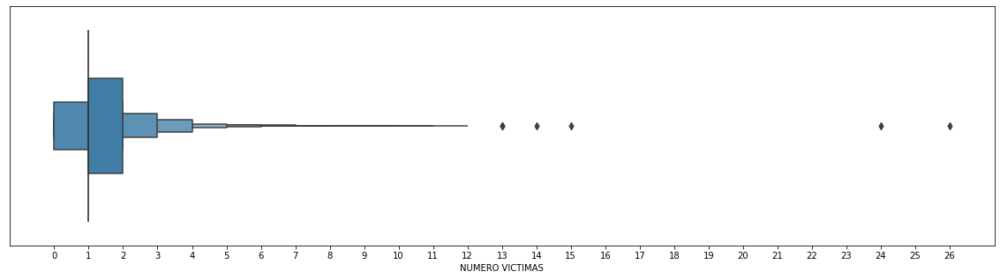

In [53]:
# 111
plt.figure(figsize=(20,5))
sns.boxenplot(accidentes['NUMERO VICTIMAS'])
plt.xticks(np.arange(0, 26+1, 1))
increments = 1
ax = plt.gca()
start, end = ax.get_ylim()
ax.yaxis.set_ticks(np.arange(start, end, increments))

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Distrito')

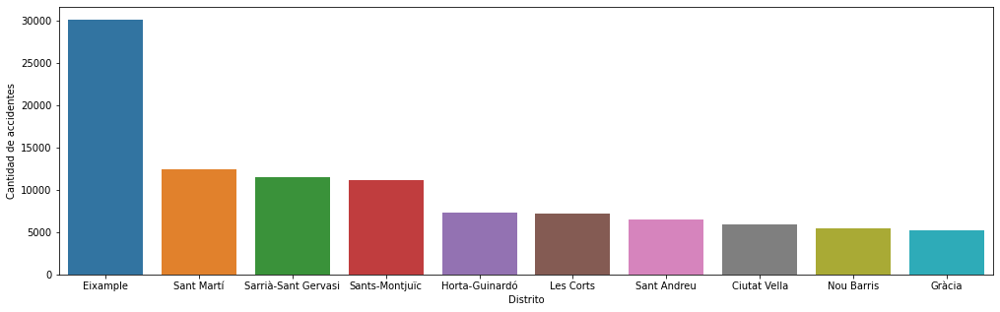

In [54]:
# 222
plt.figure(figsize=(17,5))
sns.countplot(accidentes['DISTRITO'], order= accidentes['DISTRITO'].value_counts().index)
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Distrito')

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Día de la semana')

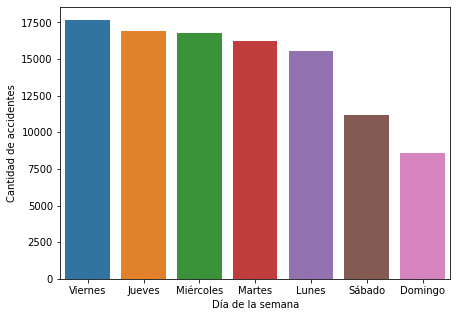

In [55]:
# 333
plt.figure(figsize=(7,5))
sns.countplot(accidentes['DIA SEMANA'], order= accidentes['DIA SEMANA'].value_counts().index)
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Día de la semana')

In [56]:
accidentes.columns

Index(['NUMERO EXPEDIENTE', 'DISTRITO', 'BARRIO', 'CALLE', 'DIA SEMANA', 'ANO',
       'MES', 'DIA', 'HORA', 'TURNO', 'NUMERO VICTIMAS', 'VICTIMAS LEVES',
       'VICTIMAS GRAVES', 'VICTIMAS FALLECIDAS'],
      dtype='object')

In [57]:
accidentes['DISTRITO'].unique()

array(['Sant Martí', 'Ciutat Vella', 'Eixample', 'Sants-Montjuïc',
       'Les Corts', 'Sarrià-Sant Gervasi', 'Gràcia', 'Horta-Guinardó',
       'Nou Barris', 'Sant Andreu', nan], dtype=object)

In [58]:
distritos_turisticos = accidentes[(accidentes['DISTRITO'] == 'Eixample')|(accidentes['DISTRITO'] == 'Gràcia')|(accidentes['DISTRITO'] == 'Ciutat Vella')]

In [59]:
barrios_turisticos = accidentes[(accidentes['BARRIO'] == 'el Barri Gòtic')|(accidentes['BARRIO'] == 'la Barceloneta')|(accidentes['BARRIO'] == 'el Poble Sec')|(accidentes['BARRIO'] == 'el Poblenou')|(accidentes['BARRIO'] == 'Sant Pere, Santa Caterina i la Ribera')|(accidentes['BARRIO'] == 'la Sagrada Família')|(accidentes['BARRIO'] == 'la Nova Esquerra de l\'Eixample')|(accidentes['BARRIO'] == 'el Fort Pienc')|(accidentes['BARRIO'] == "l'Antiga Esquerra de l'Eixample")|(accidentes['BARRIO'] == 'la Dreta de l\'Eixample')|(accidentes['BARRIO'] == 'Sant Antoni')]                         

Text(0.5, 0, 'Cantidad de accidentes')

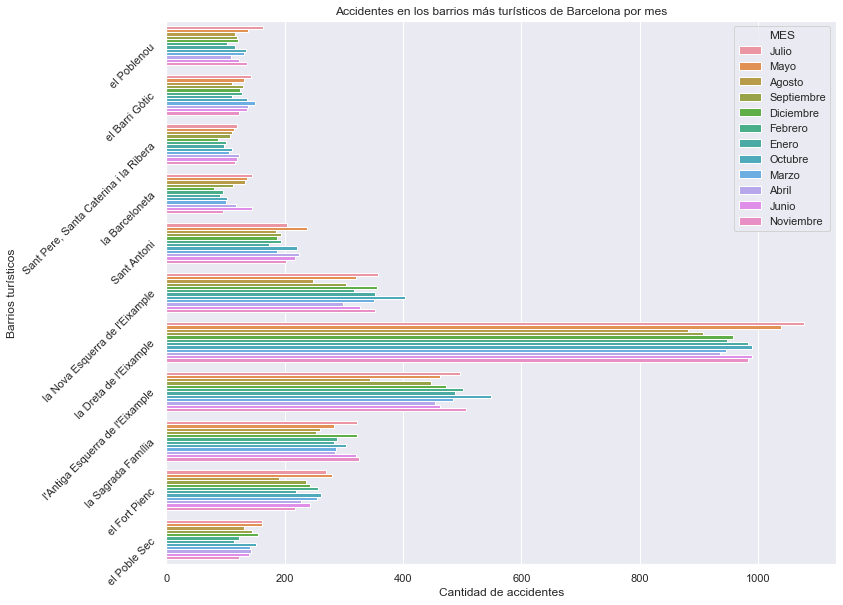

In [60]:
# 444
sns.set(rc={"figure.figsize":(12,10)})
sns.countplot(y = "BARRIO", hue = "MES", data = barrios_turisticos)
sns.set_style("whitegrid")
plt.title("Accidentes en los barrios más turísticos de Barcelona por mes")
plt.ylabel("Barrios turísticos")
plt.yticks(rotation = 45)
plt.xlabel("Cantidad de accidentes")
#plt.legend(
 #   ['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre'])

(0.5, 27.3)

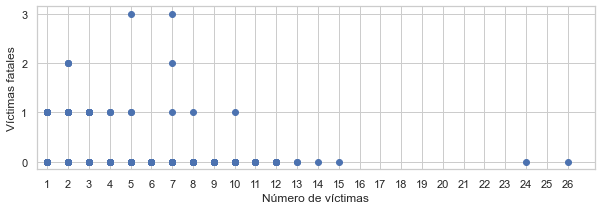

In [61]:
# 555
plt.figure(figsize=(10,3))
plt.scatter(accidentes['NUMERO VICTIMAS'], accidentes['VICTIMAS FALLECIDAS'])
plt.yticks(np.arange(0, accidentes['VICTIMAS FALLECIDAS'].max() + 1 , 1))
plt.xticks(np.arange(1, accidentes['NUMERO VICTIMAS'].max() + 1 , 1))
plt.xlabel('Número de víctimas')
plt.ylabel('Víctimas fatales')
plt.xlim(0.5)


In [62]:
accidentes['VICTIMAS FALLECIDAS'].max()

3

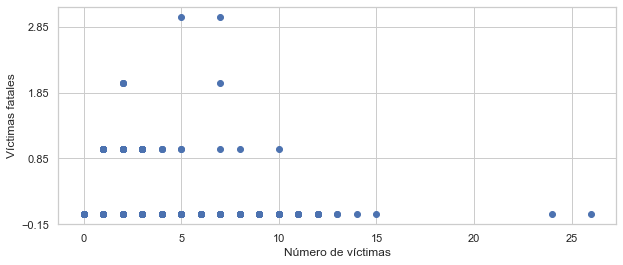

In [63]:
plt.figure(figsize=(10,4))
plt.scatter(accidentes['NUMERO VICTIMAS'], accidentes['VICTIMAS FALLECIDAS'])
plt.xlabel('Número de víctimas')
plt.ylabel('Víctimas fatales')
plt.yticks(np.arange(0, accidentes['VICTIMAS FALLECIDAS'].max() + 1 , 1))
increments = 1
ax = plt.gca()
start, end = ax.get_ylim()
ax.yaxis.set_ticks(np.arange(start, end, increments))

Text(0.5, 0, 'Cantidad de accidentes')

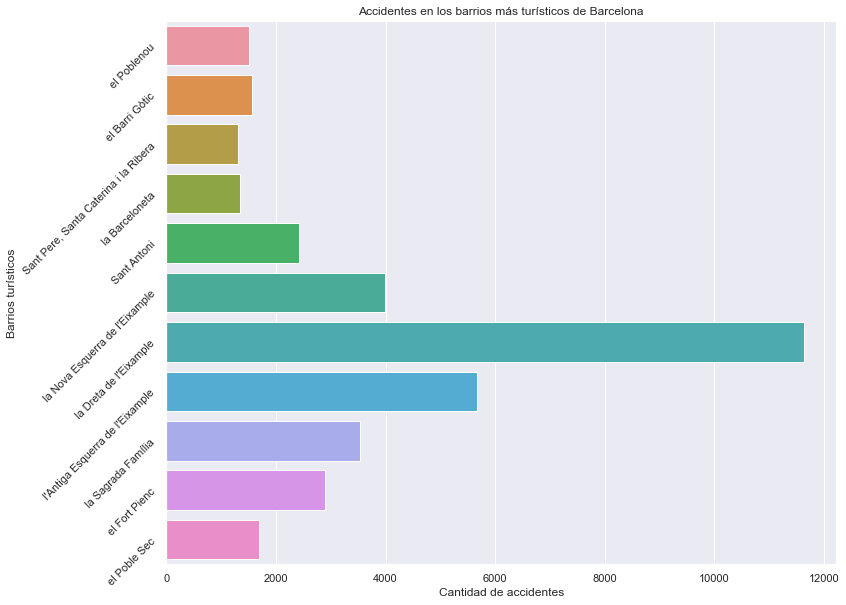

In [64]:
# 666
sns.set(rc={"figure.figsize":(12,10)})
sns.countplot(y = "BARRIO", data = barrios_turisticos)
sns.set_style("whitegrid")
plt.title("Accidentes en los barrios más turísticos de Barcelona")
plt.ylabel("Barrios turísticos")
plt.yticks(rotation = 45)
plt.xlabel("Cantidad de accidentes")

Text(0.5, 0, 'Cantidad de accidentes')

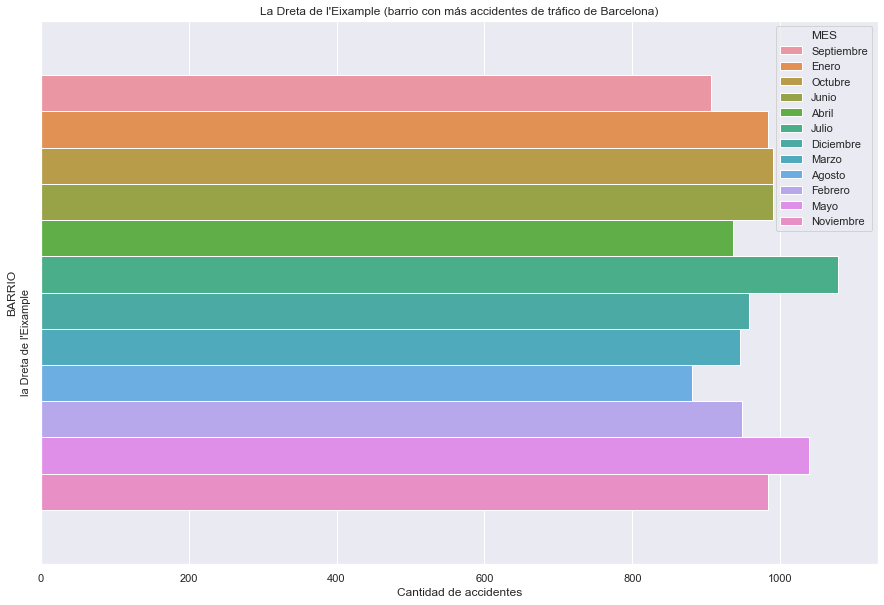

In [65]:
# 777
sns.set(rc={"figure.figsize":(15,10)})
sns.countplot(y = "BARRIO",hue = 'MES', data = barrios_turisticos[barrios_turisticos['BARRIO'] == "la Dreta de l'Eixample"])
sns.set_style("whitegrid")
plt.title("La Dreta de l'Eixample (barrio con más accidentes de tráfico de Barcelona)")
plt.yticks(rotation = 90)
plt.xlabel("Cantidad de accidentes")

(array([0, 1, 2]),
 [Text(0, 0, 'Ciutat Vella'), Text(0, 1, 'Eixample'), Text(0, 2, 'Gràcia')])

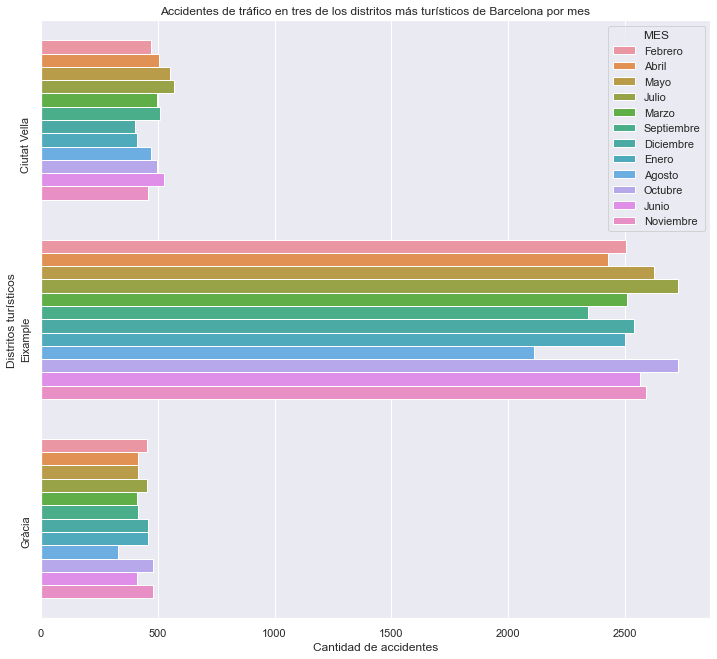

In [66]:
# 888
sns.set(rc={"figure.figsize":(12,11)})
sns.countplot(y = "DISTRITO", hue = "MES", data = distritos_turisticos)
sns.set_style("whitegrid")
plt.title("Accidentes de tráfico en tres de los distritos más turísticos de Barcelona por mes")
plt.ylabel("Distritos turísticos")
plt.xlabel("Cantidad de accidentes")
plt.yticks(rotation = 90)
#plt.legend(['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre'])

In [67]:
meses_temporada_alta = accidentes[(accidentes['MES'] == 'Julio')|(accidentes['MES'] == 'Agosto')|(accidentes['MES'] == 'Septiembre')]

Text(0.5, 1.0, 'Accidentes por día de la semana en función del turno')

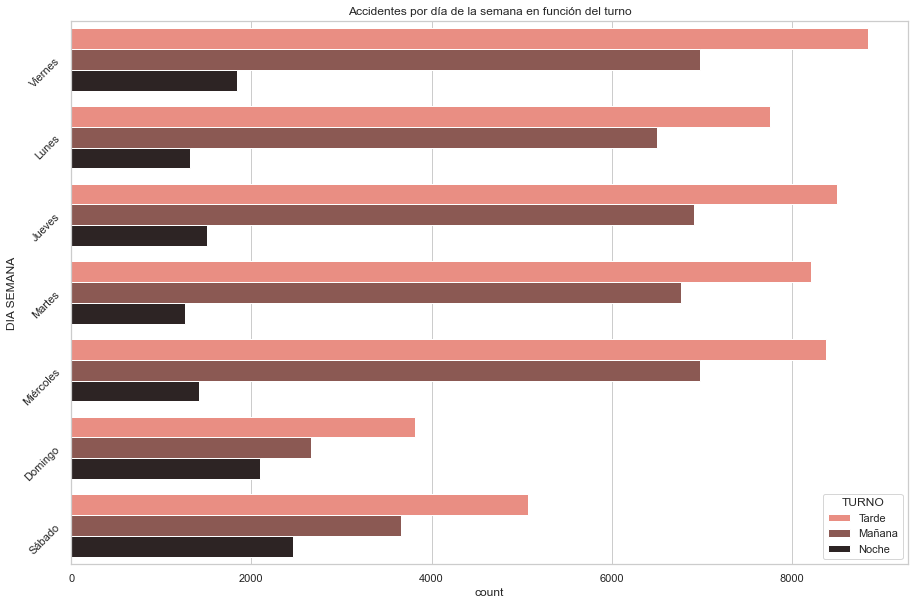

In [68]:
# 999

plt.figure(figsize=(15,10))
sns.countplot(y = accidentes['DIA SEMANA'],hue='TURNO',  data= accidentes, palette= "dark:salmon_r")
plt.yticks(rotation = 45)
plt.title("Accidentes por día de la semana en función del turno")

([<matplotlib.axis.YTick at 0x184007a6b08>,
 [Text(0, 0, 'Lunes'),
  Text(0, 1, 'Martes'),
  Text(0, 2, 'Miércoles'),
  Text(0, 3, 'Jueves'),
  Text(0, 4, 'Viernes'),
  Text(0, 5, 'Sábado'),
  Text(0, 6, 'Domingo')])

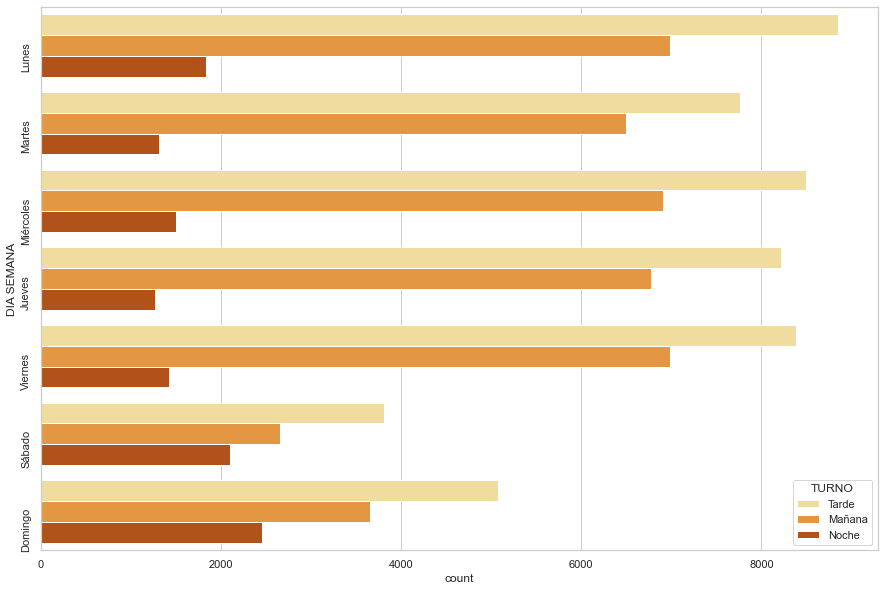

In [69]:
# 999 CON VALORES CAMBIADOS POR INTENTAR ORDENAR LOS DIAS
plt.figure(figsize=(15,10))
sns.countplot(y = accidentes['DIA SEMANA'],hue='TURNO',  data= accidentes, palette= "YlOrBr")
plt.yticks([0,1,2,3,4,5,6],['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo'], rotation = 90)



# ESTE ES EL QUE ME CAMBIO LOS VALORES .... EL DIA DE MAS ACCIDENTES ES EL VIERNES, NO EL LUNES

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your c

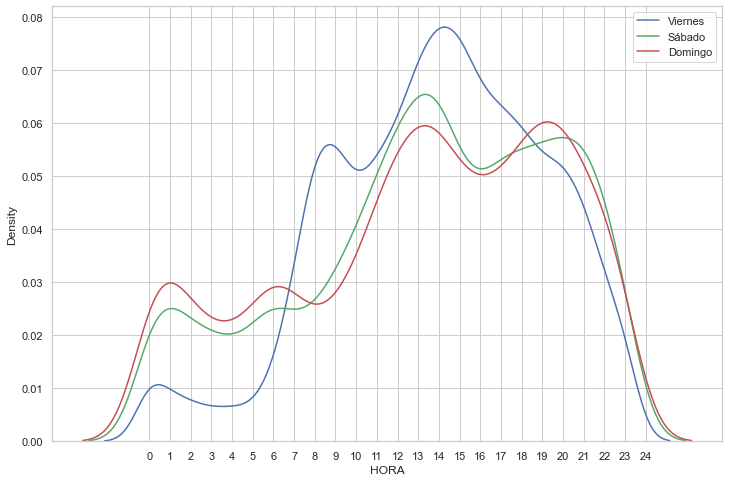

In [70]:
# 101010

accidentes_viernes = accidentes[accidentes['DIA SEMANA'] == 'Viernes']
accidentes_sabado = accidentes[accidentes['DIA SEMANA'] == 'Sábado']
accidentes_domingo = accidentes[accidentes['DIA SEMANA'] == 'Domingo']
plt.figure(figsize=(12,8))
sns.distplot(accidentes_viernes['HORA'], hist= False, color = "b", label = "Viernes")
sns.distplot(accidentes_sabado['HORA'], hist= False, color = "g", label = "Sábado")
sns.distplot(accidentes_domingo['HORA'], hist= False, color = "r", label = "Domingo")
plt.xticks(np.arange(0, 25, 1))
ax.yaxis.set_ticks(np.arange(start, end, increments))
plt.legend()

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your c

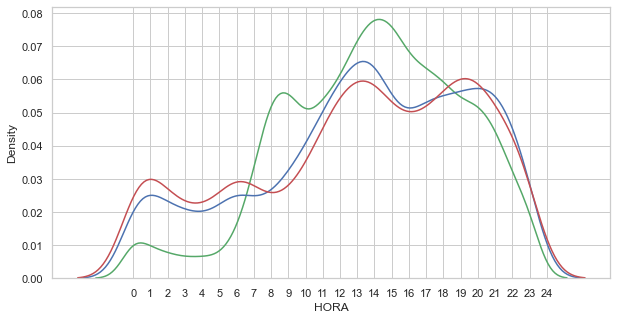

In [71]:
plt.figure(figsize=(10,5))
sns.distplot(accidentes_viernes['HORA'], hist= False, color='g')

sns.distplot(accidentes_sabado['HORA'], hist= False, color='b')
sns.distplot(accidentes_domingo['HORA'], hist= False, color='r')
plt.xticks(np.arange(0, 25, 1))
ax.yaxis.set_ticks(np.arange(start, end, increments))


C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


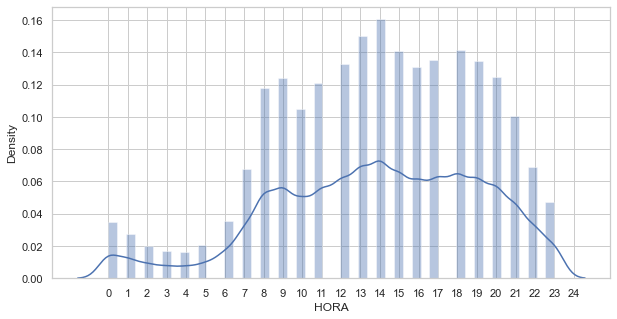

In [72]:
# 111111
plt.figure(figsize=(10,5))
sns.distplot(accidentes['HORA'])
plt.xticks(np.arange(0, 25, 1))
ax.yaxis.set_ticks(np.arange(start, end, increments))

<Figure size 1440x1440 with 0 Axes>

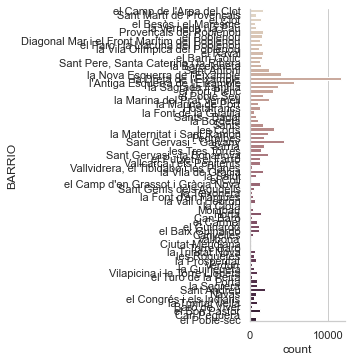

In [73]:
plt.figure(figsize=(20,20))
sns.catplot(y="BARRIO", kind="count", palette="ch:.25", data=accidentes)

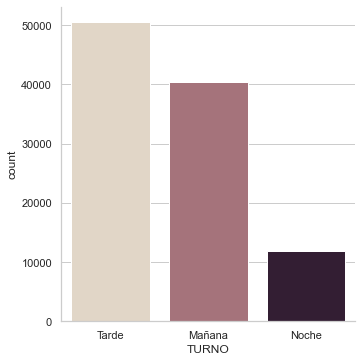

In [74]:
# 121212
sns.catplot(x="TURNO", kind="count", data=accidentes, palette="ch:s=.25")

Text(0.5, 0, 'Cantidad de accidentes')

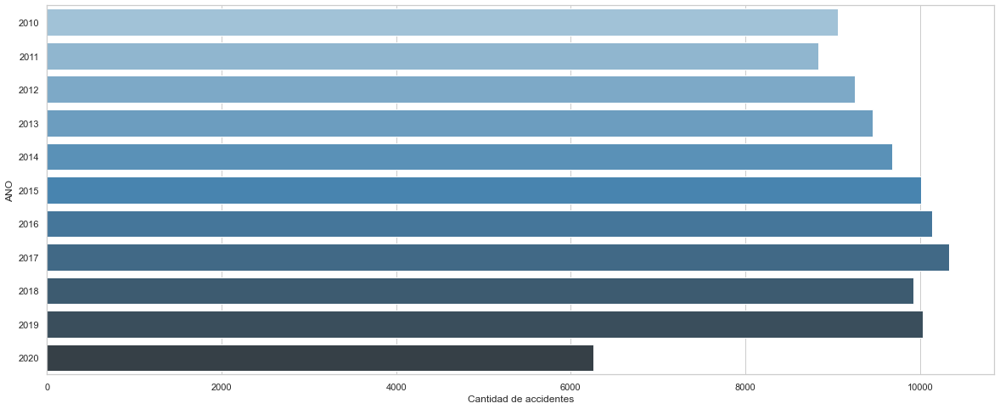

In [75]:
# 131313

plt.figure(figsize=(20,8))
sns.countplot(y = 'ANO',
           palette = 'Blues_d',
           data = accidentes)
plt.xlabel('Cantidad de accidentes')

<AxesSubplot:>

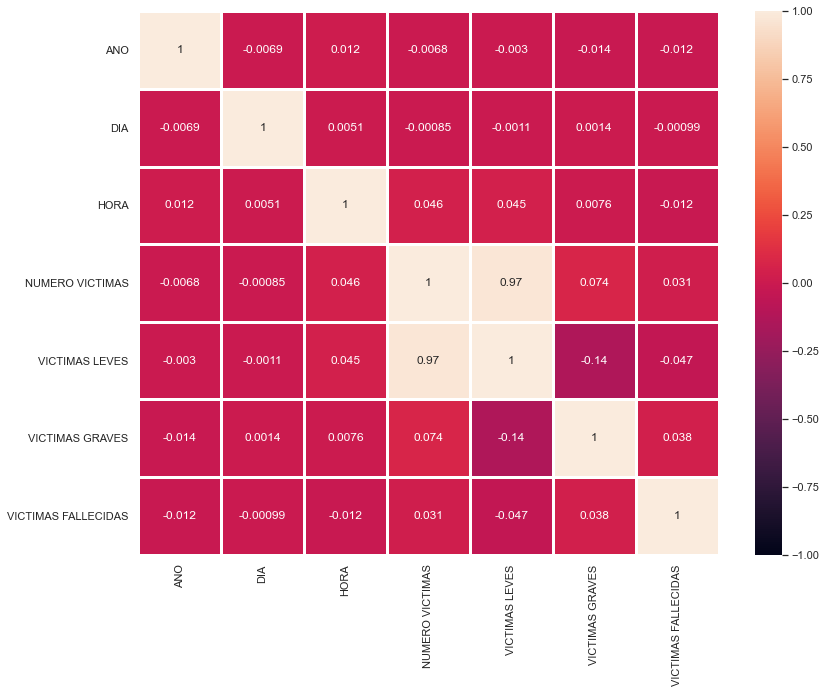

In [76]:
# 141414

plt.subplots(figsize=(13, 10))
sns.heatmap(accidentes.corr(),
           vmin = -1,
           vmax = 1,
            annot = True,
           linewidths = 3)

In [77]:
accidentes_x_ano = accidentes.groupby('ANO').count()

<AxesSubplot:xlabel='ANO', ylabel='NUMERO EXPEDIENTE'>

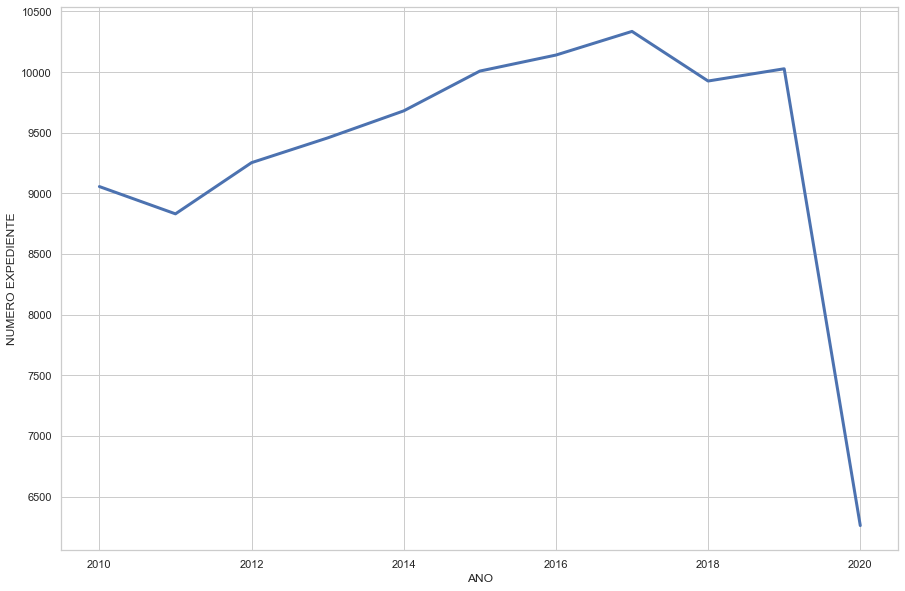

In [78]:
# 161616
plt.figure(figsize=(15,10))
sns.lineplot(data = accidentes_x_ano,
            x = 'ANO',
            y = 'NUMERO EXPEDIENTE',
            linewidth = 3)


## TEDENCIAS PARA CADA COLUMNA DEL DATASET

In [79]:
accidentes.columns

Index(['NUMERO EXPEDIENTE', 'DISTRITO', 'BARRIO', 'CALLE', 'DIA SEMANA', 'ANO',
       'MES', 'DIA', 'HORA', 'TURNO', 'NUMERO VICTIMAS', 'VICTIMAS LEVES',
       'VICTIMAS GRAVES', 'VICTIMAS FALLECIDAS'],
      dtype='object')

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73]),
 [Text(0, 0, "la Dreta de l'Eixample"),
  Text(1, 0, "l'Antiga Esquerra de l'Eixample"),
  Text(2, 0, 'Sant Gervasi - Galvany'),
  Text(3, 0, "la Nova Esquerra de l'Eixample"),
  Text(4, 0, 'la Sagrada Família'),
  Text(5, 0, 'les Corts'),
  Text(6, 0, 'el Fort Pienc'),
  Text(7, 0, 'Sant Antoni'),
  Text(8, 0, 'la Marina del Prat Vermell'),
  Text(9, 0, 'Sant Gervasi - la Bonanova'),
  Text(10, 0, 'la Maternitat i Sant Ramon'),
  Text(11, 0, 'Sant Andreu'),
  Text(12, 0, 'Sarrià'),
  Text(13, 0, 'Pedralbes'),
  Text(14, 0, 'la Vila de Gràcia'),
  Text(15, 0, 'el Poble Sec'),
  Text(16, 0, 'Sants'),
  Text(17, 0, 'Provençals del Poblenou'),
  Text(18, 0,

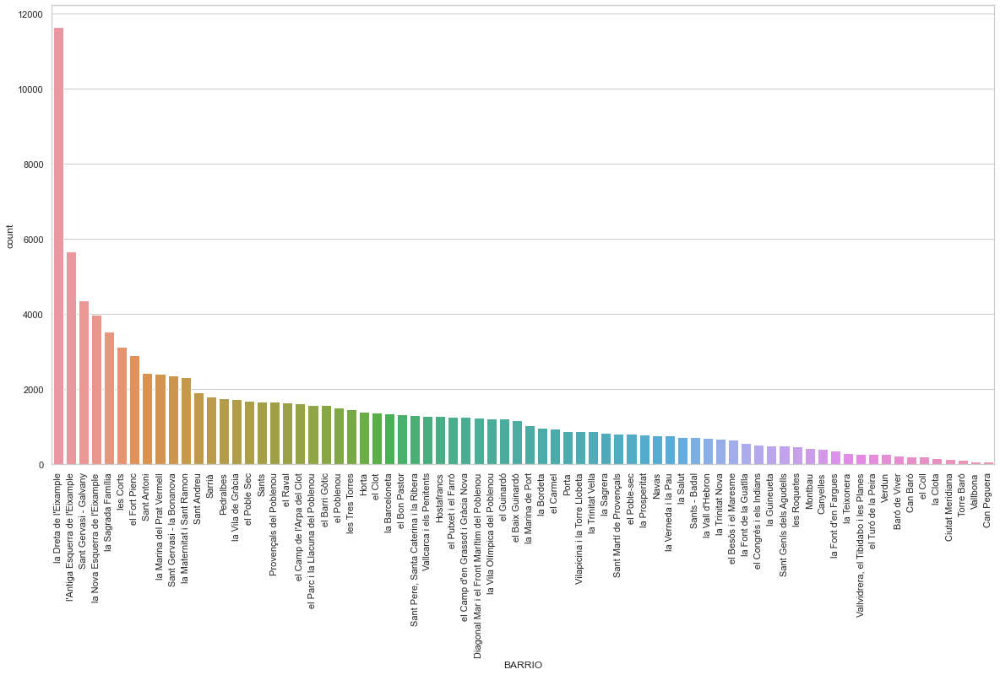

In [80]:
# 141414
plt.figure(figsize=(20,10))
sns.countplot(accidentes['BARRIO'], order= accidentes['BARRIO'].value_counts().index)
plt.xticks(rotation = 90)

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 [Text(0, 0, 'Octubre'),
  Text(1, 0, 'Julio'),
  Text(2, 0, 'Noviembre'),
  Text(3, 0, 'Mayo'),
  Text(4, 0, 'Marzo'),
  Text(5, 0, 'Junio'),
  Text(6, 0, 'Diciembre'),
  Text(7, 0, 'Febrero'),
  Text(8, 0, 'Enero'),
  Text(9, 0, 'Septiembre'),
  Text(10, 0, 'Abril'),
  Text(11, 0, 'Agosto')])

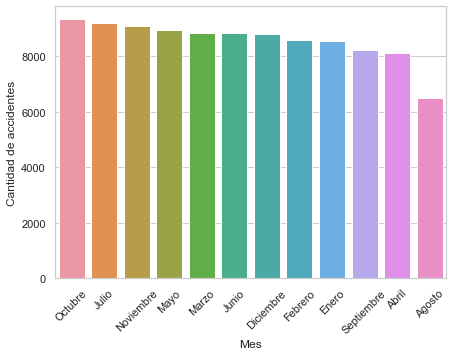

In [86]:
# 171717
plt.figure(figsize=(7,5))
sns.countplot(accidentes['MES'], order= accidentes['MES'].value_counts().index)
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Mes')
plt.xticks(rotation = 45)

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Día del mes')

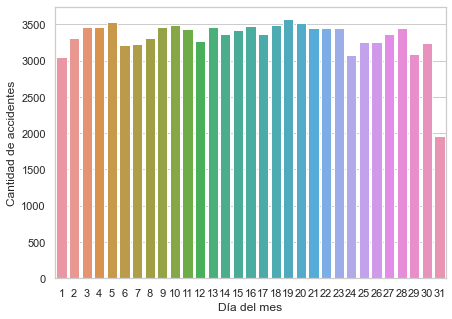

In [88]:
# 181818
plt.figure(figsize=(7,5))
sns.countplot(accidentes['DIA'])
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Día del mes')
#plt.xticks(rotation = 45)

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Número de víctimas')

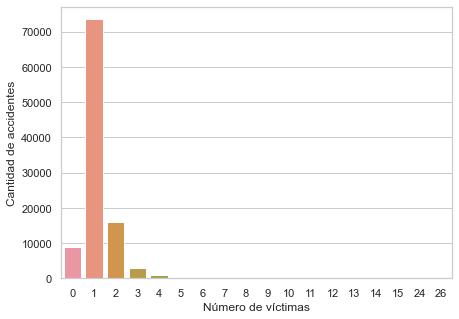

In [95]:
# 191919

plt.figure(figsize=(7,5))
sns.countplot(accidentes['NUMERO VICTIMAS'])
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Número de víctimas por accidente')

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Número de víctimas leves')

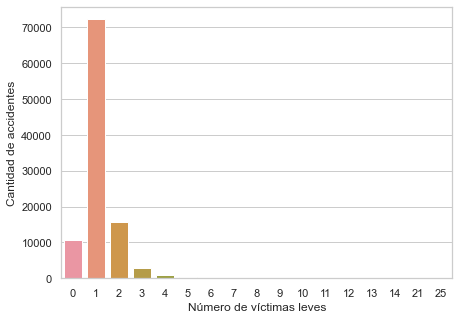

In [98]:
# 202020

plt.figure(figsize=(7,5))
sns.countplot(accidentes['VICTIMAS LEVES'])
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Número de víctimas leves por accidente')

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Número de víctimas graves')

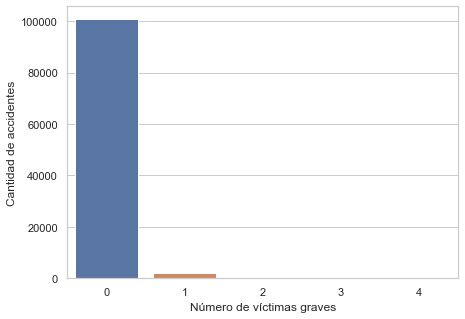

In [99]:
# 212121

plt.figure(figsize=(7,5))
sns.countplot(accidentes['VICTIMAS GRAVES'])
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Número de víctimas graves por accidente')

C:\Users\LeoFr\AppData\Local\Programs\Python\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


Text(0.5, 0, 'Número de víctimas fatales por accidente')

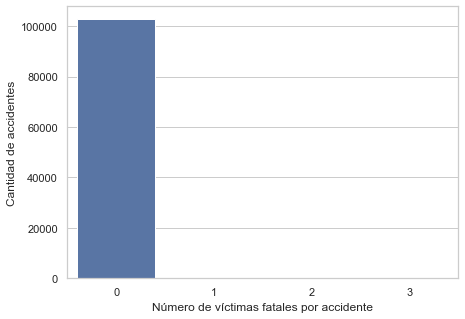

In [100]:
# 222222

plt.figure(figsize=(7,5))
sns.countplot(accidentes['VICTIMAS FALLECIDAS'])
plt.ylabel('Cantidad de accidentes')
plt.xlabel('Número de víctimas fatales por accidente')